# Haber2017 (GSE92332_mouse_small_intestine) 
# Annotate cell types

In [1]:
# load required modules
import scanpy as sc
import besca as bc
import pandas as pd
import numpy as np
import os
import pkg_resources

#import numpy as np
#from matplotlib import pyplot
#import sys

#setup document
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures
sc.logging.print_header()

scanpy==1.6.0 anndata==0.7.4 umap==0.3.10 numpy==1.17.4 scipy==1.5.1 pandas==1.0.5 scikit-learn==0.22 statsmodels==0.11.1 python-igraph==0.8.0 leidenalg==0.7.0


In [2]:
# define filepath (this is the folder that contains "raw" and "analyzed")
root_path = os.getcwd()

# input: results from standard workflow
analysis_name = 'standard_workflow_besca'
results_folder = os.path.join(root_path, 'analyzed', analysis_name)
input_data = os.path.join(results_folder, 'standard_workflow_besca.h5ad') # specify a .h5ad file for storing the results

# define output directories
outdir_data = results_folder
outdir_figures = os.path.join(results_folder, 'figures')
outdir_results = os.path.join(results_folder, 'results')
sc.settings.figdir = os.path.join(outdir_figures)

os.makedirs(outdir_data, exist_ok=True)
os.makedirs(outdir_figures, exist_ok=True)
os.makedirs(outdir_results, exist_ok=True)

In [3]:
#reload our data from previously written out AnnData object
adata = sc.read(input_data)
#adata = bc.datasets.Haber2017_processed()

In [4]:
adata = bc.st.additional_labeling(adata, 'leiden', 'leiden', 'Leiden clustering from standard workflow.', 'Klas Hatje', outdir_data)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:15)
rank genes per label calculated using method wilcoxon.
mapping of cells to  leiden exported successfully to cell2labels.tsv
average.gct exported successfully to file
fract_pos.gct exported successfully to file
labelinfo.tsv successfully written out
/pstore/data/bi/reference/scseq/GSE92332_mouse_small_intestine/analyzed/standard_workflow_besca/labelings/leiden/WilxRank.gct written out
/pstore/data/bi/reference/scseq/GSE92332_mouse_small_intestine/analyzed/standard_workflow_besca/labelings/leiden/WilxRank.pvalues.gct written out
/pstore/data/bi/reference/scseq/GSE92332_mouse_small_intestine/analyzed/standard_wo

In [5]:
adata

AnnData object with n_obs × n_vars = 10896 × 1233
    obs: 'CELL', 'CONDITION', 'sample_type', 'donor', 'region', 'sample', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden'
    var: 'ENSEMBL', 'SYMBOL', 'n_cells', 'total_counts', 'frac_reads', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'region_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [6]:
adata.obs.head()

,CELL,CONDITION,sample_type,donor,region,sample,percent_mito,n_counts,n_genes,batch,leiden
haber_intestine_donor_M1_Duo.AAACATACAGCGGA,haber_intestine_donor_M1_Duo.AAACATACAGCGGA,healthy,mouse_small_intestine_epithelial,M1,Duo,Duo_M1,0.001410,12768.0,1227,Duo,22
haber_intestine_donor_M1_Duo.AAACATACCTTACT,haber_intestine_donor_M1_Duo.AAACATACCTTACT,healthy,mouse_small_intestine_epithelial,M1,Duo,Duo_M1,0.010779,6583.0,2156,Duo,3
haber_intestine_donor_M1_Duo.AAACCGTGCAGTCA,haber_intestine_donor_M1_Duo.AAACCGTGCAGTCA,healthy,mouse_small_intestine_epithelial,M1,Duo,Duo_M1,0.022508,2799.0,1362,Duo,1
haber_intestine_donor_M1_Duo.AAACGCTGCAGTCA,haber_intestine_donor_M1_Duo.AAACGCTGCAGTCA,healthy,mouse_small_intestine_epithelial,M1,Duo,Duo_M1,0.015041,6048.0,2287,Duo,9
haber_intestine_donor_M1_Duo.AAACGCTGCGTGAT,haber_intestine_donor_M1_Duo.AAACGCTGCGTGAT,healthy,mouse_small_intestine_epithelial,M1,Duo,Duo_M1,0.023022,2780.0,1320,Duo,17


In [7]:
%matplotlib inline  
sc.settings.set_figure_params(dpi=90)

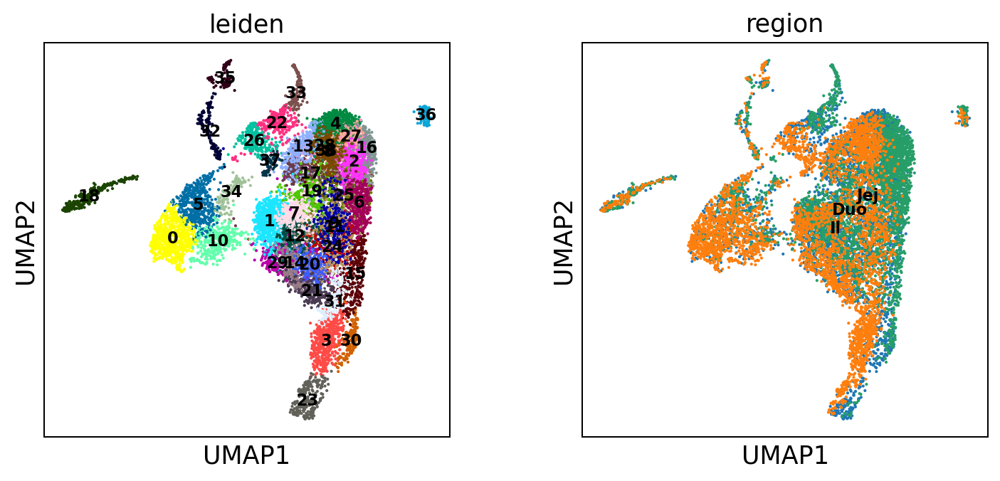

In [8]:
sc.pl.umap(adata, color=['leiden', 'region'], legend_loc='on data', legend_fontsize=9)

computing tSNE
    using 'X_pca' with n_pcs = 50
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:01:13)


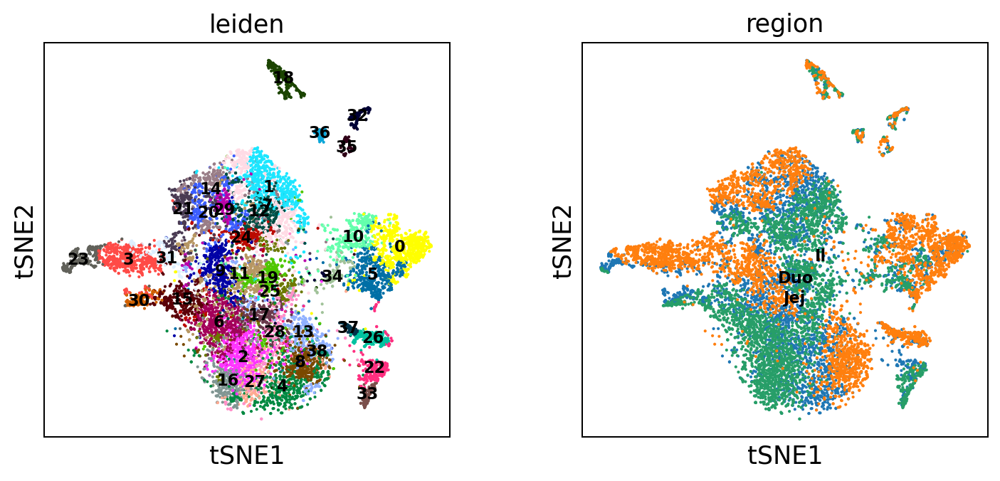

In [9]:
sc.tl.tsne(adata)
sc.pl.tsne(adata, color=['leiden', 'region'], legend_loc='on data', legend_fontsize=9)

In [10]:
#sc.pl.umap(adata, color=['leiden', 'celltype'], legend_loc='on data', legend_fontsize=6)

In [11]:
#sc.pl.umap(adata, color=['Subtype'], legend_fontsize=9)

In [12]:
### Perform DE cells of each Subtype vs. all other cells
DEgenes=bc.tl.dge.get_de(adata,'leiden',demethod='wilcoxon',topnr=5000, logfc=1,padj=0.05)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:15)


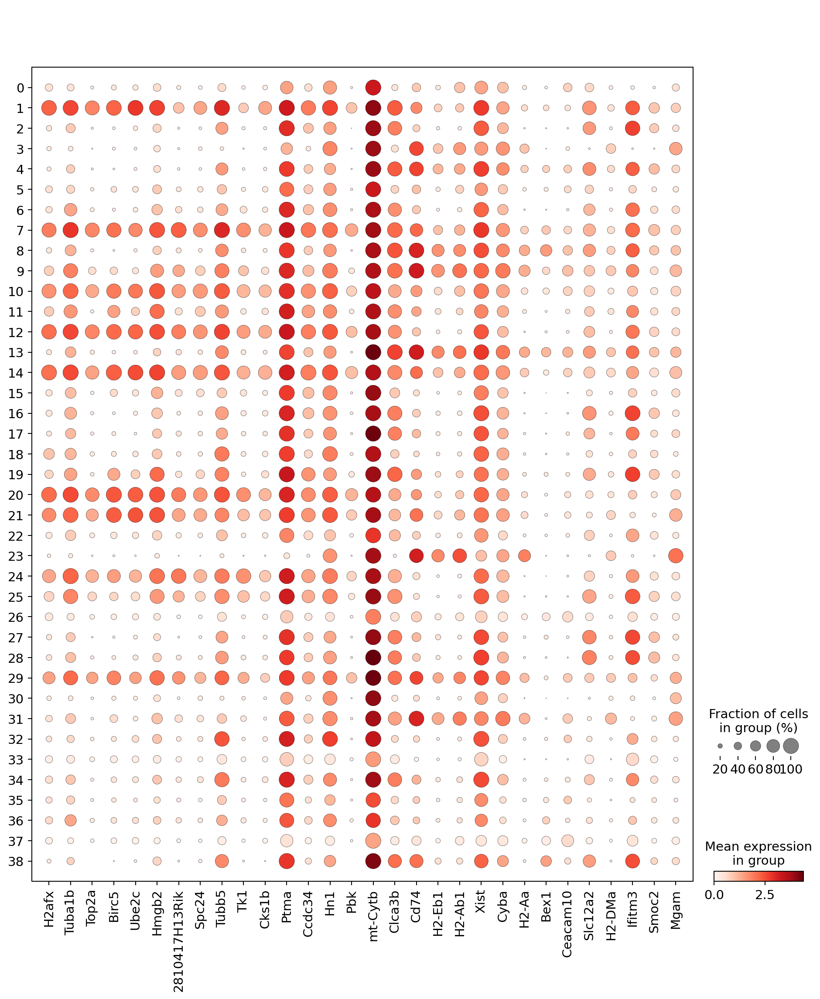

In [13]:
### Select only top genes (in order of p-val) and plot expression per cell type
tops=list(DEgenes['12']['Name'][0:15])+list(DEgenes['13']['Name'][0:15])
#tops=list(DEgenes['Naive T cells']['Name'][0:30])
sc.pl.dotplot(adata, var_names=tops,groupby='leiden')

In [14]:
#sc.pl.dotplot(adata, var_names=['SELL', 'CCR7', 'ID3', 'TCF7', 'LEF1', 'NELL2', 'PASK', 'FLT3LG', 'CAMK4', 'MAL'],groupby='Subtype')

In [15]:
# Load GMT file and calculate signature scores
gmt_file_IMM=pkg_resources.resource_filename('besca', 'datasets/genesets/HumanCD45p_scseqCMs6.gmt')
gmt_file_anno=pkg_resources.resource_filename('besca', 'datasets/genesets/CellNames_scseqCMs6_sigs.gmt')
gmt_file_crypt=pkg_resources.resource_filename('besca', 'datasets/genesets/CryptScoreParikh2019.gmt')

mousehuman_file = pkg_resources.resource_filename('besca', 'datasets/homologs/MGItoHGNC.csv')

mousehuman=pd.read_csv(mousehuman_file,sep='\t',header='infer', encoding="unicode_escape")
mousehuman.index=mousehuman['MGI']
conversion=pd.Series(data=mousehuman['HGNC'], index=mousehuman.index)

adata_IMM_scores = adata.copy()
adata_anno_scores = adata.copy()
adata_crypt_scores = adata.copy()

bc.tl.sig.combined_signature_score(adata_IMM_scores, gmt_file_IMM, conversion=conversion)
bc.tl.sig.combined_signature_score(adata_anno_scores, gmt_file_anno, conversion=conversion)
bc.tl.sig.combined_signature_score(adata_crypt_scores, gmt_file_crypt, conversion=conversion)

computing score 'score_HumanCD45p_scseqCMs6_ActB_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_ActB_scanpyUP', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_Activation_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Activation_scanpyUP', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_Basophil_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Basophil_scanpyUP', score of gene set (adata.obs).
    300 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_Bcells_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Bcells_scanpyUP', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_CCG1S_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_CCG1S_scanpyUP', score of gene set (adata.o

computing score 'score_HumanCD45p_scseqCMs6_Megakaryocytes_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Megakaryocytes_scanpyUP', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_MelMelan_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_MelMelan_scanpyUP', score of gene set (adata.obs).
    300 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_MelMesen_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_MelMesen_scanpyUP', score of gene set (adata.obs).
    499 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_MemB_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_MemB_scanpyUP', score of gene set (adata.obs).
    250 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_Memory_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Memory_scanpyUP', score of 

    finished: added
    'score_HumanCD45p_scseqCMs6_TMO_scanpyUP', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_TMid_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_TMid_scanpyUP', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_TNK_scanpyUP'
computing score 'score_HumanCD45p_scseqCMs6_TStem_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_TStem_scanpyUP', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_TStemhi_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_TStemhi_scanpyUP', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_TSteml_scanpyUP'
computing score 'score_HumanCD45p_scseqCMs6_TStemlo_scanpyUP'
computing score 'score_HumanCD45p_scseqCMs6_TTh1_s

computing score 'score_HumanCD45p_scseqCMs6_epDCs_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_epDCs_scanpyUP', score of gene set (adata.obs).
    149 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_general_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_general_scanpyUP', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_moDC_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_moDC_scanpyUP', score of gene set (adata.obs).
    99 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_pDCs_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_pDCs_scanpyUP', score of gene set (adata.obs).
    400 total control genes are used. (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_uDCs_scanpyUP'
computing score 'score_Bcell_scanpyUP'
computing score 'score_Fibroblast_scanpyUP'
    finished: added
    'sc

    finished: added
    'score_NaiCD8Tcell_scanpyUP', score of gene set (adata.obs).
    149 total control genes are used. (0:00:00)
computing score 'score_ProlifCD8Tcell_scanpyUP'
    finished: added
    'score_ProlifCD8Tcell_scanpyUP', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'score_ProlifCD4Tcell_scanpyUP'
    finished: added
    'score_ProlifCD4Tcell_scanpyUP', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'score_ProlifBcell_scanpyUP'
    finished: added
    'score_ProlifBcell_scanpyUP', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'score_CMCD4Tcell_scanpyUP'
    finished: added
    'score_CMCD4Tcell_scanpyUP', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'score_EMCD8Tcell_scanpyUP'
    finished: added
    'score_EMCD8Tcell_scanpyUP', score of gene set (adata.obs).
    100 total con

computing score 'score_EntericGlial_scanpyUP'
    finished: added
    'score_EntericGlial_scanpyUP', score of gene set (adata.obs).
    149 total control genes are used. (0:00:00)
computing score 'score_Adipocyte_scanpyUP'
    finished: added
    'score_Adipocyte_scanpyUP', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'score_Chondrocyte_scanpyUP'
    finished: added
    'score_Chondrocyte_scanpyUP', score of gene set (adata.obs).
    149 total control genes are used. (0:00:00)
computing score 'score_HematoMultipotentPC_scanpyUP'
    finished: added
    'score_HematoMultipotentPC_scanpyUP', score of gene set (adata.obs).
    148 total control genes are used. (0:00:00)
computing score 'score_HematoStem_scanpyUP'
    finished: added
    'score_HematoStem_scanpyUP', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'score_Basophil_scanpyUP'
computing score 'score_CommonLymphoidPC_scanpyUP'
    fini

computing score 'score_McellGut_scanpyUP'
    finished: added
    'score_McellGut_scanpyUP', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'score_Mast_scanpyUP'
    finished: added
    'score_Mast_scanpyUP', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'score_ColorectalCancer_scanpyUP'
    finished: added
    'score_ColorectalCancer_scanpyUP', score of gene set (adata.obs).
    200 total control genes are used. (0:00:00)
computing score 'score_T1Pneumocyte_scanpyUP'
    finished: added
    'score_T1Pneumocyte_scanpyUP', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'score_T2Pneumocyte_scanpyUP'
    finished: added
    'score_T2Pneumocyte_scanpyUP', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'score_Pneumocyte_scanpyUP'
    finished: added
    'score_Pneumocyte_scanpyUP', score of gene set (a

In [16]:
adata_anno_scores

AnnData object with n_obs × n_vars = 10896 × 1233
    obs: 'CELL', 'CONDITION', 'sample_type', 'donor', 'region', 'sample', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden', 'score_Bcell_scanpy', 'score_Fibroblast_scanpy', 'score_Endothelial_scanpy', 'score_Epithelial_scanpy', 'score_Granulocyte_scanpy', 'score_MelMelanoma_scanpy', 'score_MemBcell_scanpy', 'score_Myeloid_scanpy', 'score_NKcell_scanpy', 'score_NaiBcell_scanpy', 'score_Neutrophil_scanpy', 'score_Plasma_scanpy', 'score_CD4Tcell_scanpy', 'score_CD8Tcell_scanpy', 'score_Tcell_scanpy', 'score_CD8Tcell_IL7Rmax_scanpy', 'score_CD4Tcell_IL7Rmax_scanpy', 'score_RegTcell_scanpy', 'score_cDC1_scanpy', 'score_cDC2_scanpy', 'score_cDC_scanpy', 'score_NClassMonocyte_scanpy', 'score_pDC_scanpy', 'score_Hematopoietic_scanpy', 'score_Blymphocyte_scanpy', 'score_CD56dimNK_scanpy', 'score_CD56brightNK_scanpy', 'score_NaiCD4Tcell_scanpy', 'score_NaiCD8Tcell_scanpy', 'score_ProlifCD8Tcell_scanpy', 'score_ProlifCD4Tcell_scanpy', 'sco

In [17]:
adata_IMM_scores

AnnData object with n_obs × n_vars = 10896 × 1233
    obs: 'CELL', 'CONDITION', 'sample_type', 'donor', 'region', 'sample', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden', 'score_HumanCD45p_scseqCMs6_ActB_scanpy', 'score_HumanCD45p_scseqCMs6_Activation_scanpy', 'score_HumanCD45p_scseqCMs6_Basophil_scanpy', 'score_HumanCD45p_scseqCMs6_Bcells_scanpy', 'score_HumanCD45p_scseqCMs6_CCG1S_scanpy', 'score_HumanCD45p_scseqCMs6_CCG2M_scanpy', 'score_HumanCD45p_scseqCMs6_Cafs_scanpy', 'score_HumanCD45p_scseqCMs6_Cellcycle_scanpy', 'score_HumanCD45p_scseqCMs6_Checkpoint_scanpy', 'score_HumanCD45p_scseqCMs6_Cyto_scanpy', 'score_HumanCD45p_scseqCMs6_Cytotox_scanpy', 'score_HumanCD45p_scseqCMs6_DCR_scanpy', 'score_HumanCD45p_scseqCMs6_DCrec_scanpy', 'score_HumanCD45p_scseqCMs6_DCs_scanpy', 'score_HumanCD45p_scseqCMs6_Eff_scanpy', 'score_HumanCD45p_scseqCMs6_Endo_scanpy', 'score_HumanCD45p_scseqCMs6_Endot_scanpy', 'score_HumanCD45p_scseqCMs6_Endothelial_scanpy', 'score_HumanCD45p_scseqCMs6_

In [18]:
adata_crypt_scores

AnnData object with n_obs × n_vars = 10896 × 1233
    obs: 'CELL', 'CONDITION', 'sample_type', 'donor', 'region', 'sample', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden', 'score_CryptScoreParikh2019_scanpy'
    var: 'ENSEMBL', 'SYMBOL', 'n_cells', 'total_counts', 'frac_reads', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'region_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_tsne'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

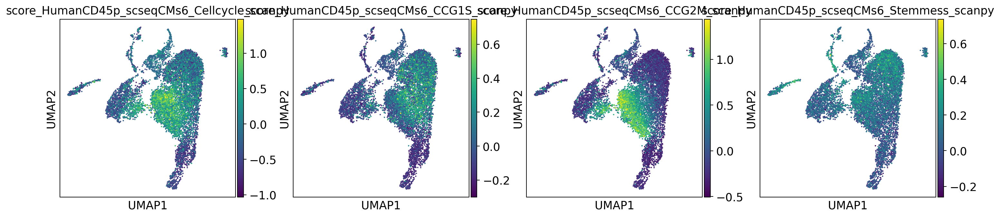

In [19]:
sc.pl.umap(adata_IMM_scores, color=['score_HumanCD45p_scseqCMs6_Cellcycle_scanpy',
                                    'score_HumanCD45p_scseqCMs6_CCG1S_scanpy',
                                    'score_HumanCD45p_scseqCMs6_CCG2M_scanpy',
                                    'score_HumanCD45p_scseqCMs6_Stemmess_scanpy',
                                    ], legend_loc='on data',legend_fontsize=6)

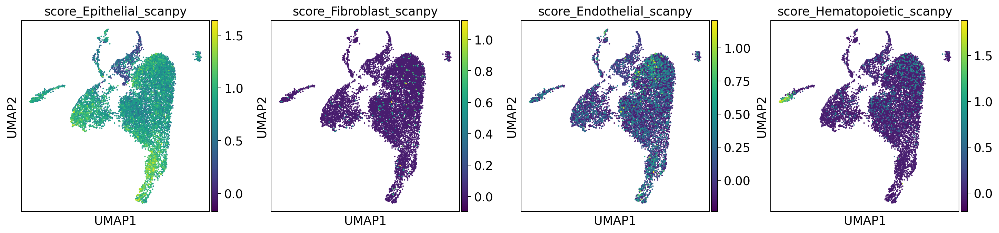

In [20]:
sc.pl.umap(adata_anno_scores, color=['score_Epithelial_scanpy',
                                     'score_Fibroblast_scanpy',
                                     'score_Endothelial_scanpy',
                                     'score_Hematopoietic_scanpy',
                                    ], legend_loc='on data',legend_fontsize=6)

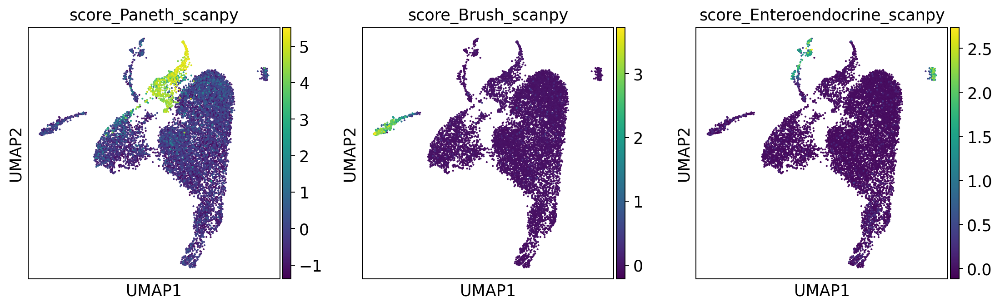

In [21]:
sc.pl.umap(adata_anno_scores, color=['score_Paneth_scanpy',
                                     'score_Brush_scanpy', # Tuft cells
                                     'score_Enteroendocrine_scanpy' # EEC
                                    ], legend_loc='on data',legend_fontsize=6)

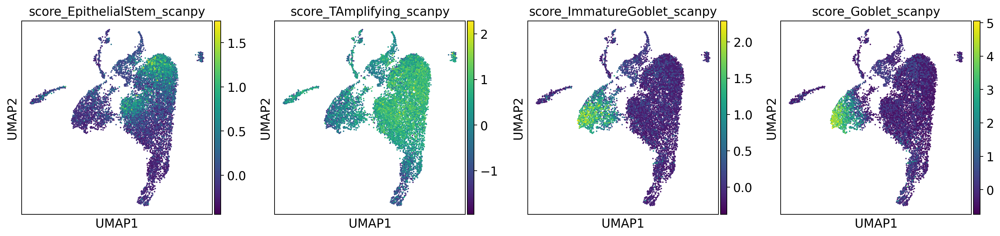

In [22]:
sc.pl.umap(adata_anno_scores, color=['score_EpithelialStem_scanpy',
                                     'score_TAmplifying_scanpy',
                                     'score_ImmatureGoblet_scanpy',
                                     'score_Goblet_scanpy',
                                    ], legend_loc='on data',legend_fontsize=6)

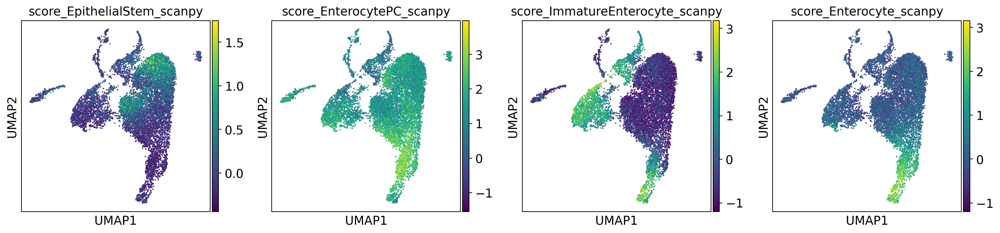

In [23]:
sc.pl.umap(adata_anno_scores, color=['score_EpithelialStem_scanpy',
                                     'score_EnterocytePC_scanpy', # Enterocyte progenitor cell
                                     'score_ImmatureEnterocyte_scanpy',
                                     'score_Enterocyte_scanpy'], legend_loc='on data',legend_fontsize=6)

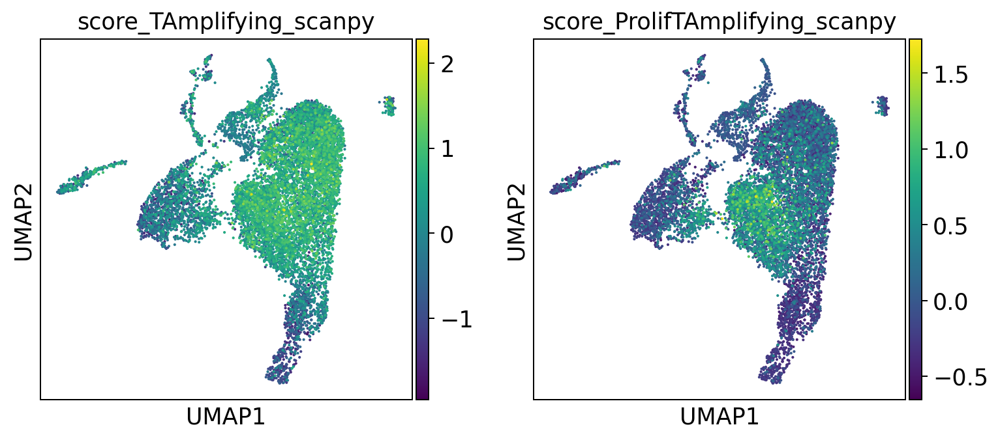

In [24]:
sc.pl.umap(adata_anno_scores, color=['score_TAmplifying_scanpy',
                                     'score_ProlifTAmplifying_scanpy',
                                    ], legend_loc='on data',legend_fontsize=6)

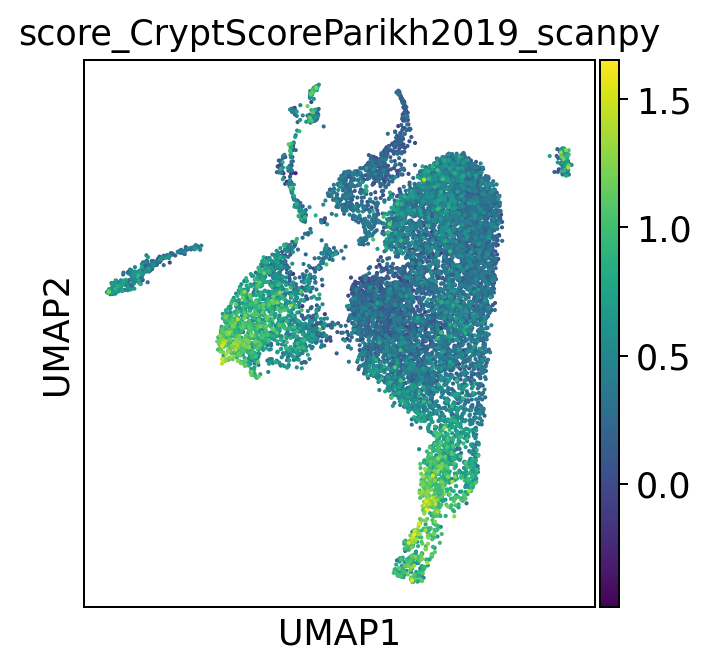

In [25]:
sc.pl.umap(adata_crypt_scores, color=['score_CryptScoreParikh2019_scanpy'], legend_loc='on data',legend_fontsize=6)

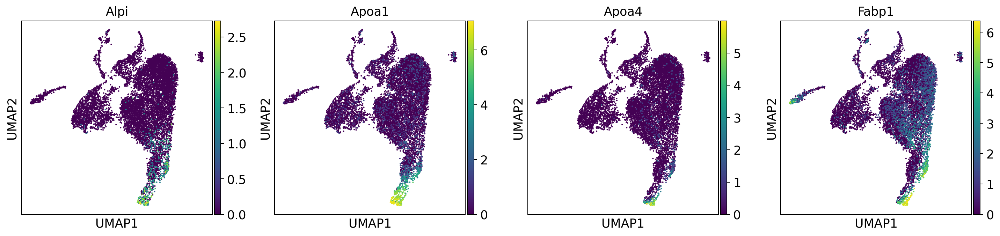

In [26]:
sc.pl.umap(adata,color=['Alpi','Apoa1','Apoa4','Fabp1']) ## enterocyte

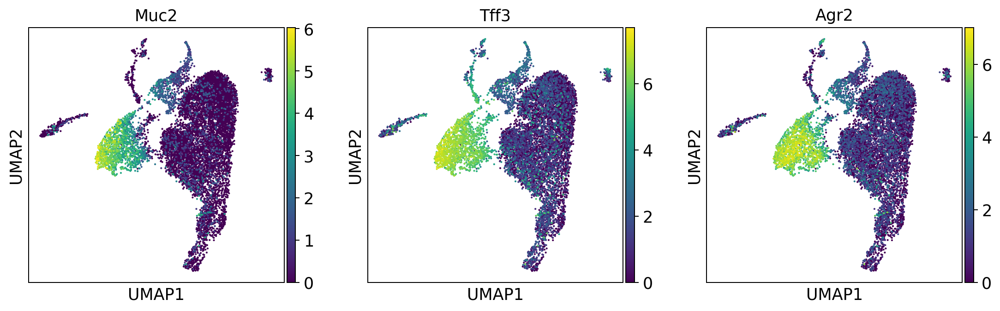

In [27]:
sc.pl.umap(adata,color=['Muc2','Tff3','Agr2']) ## goblet

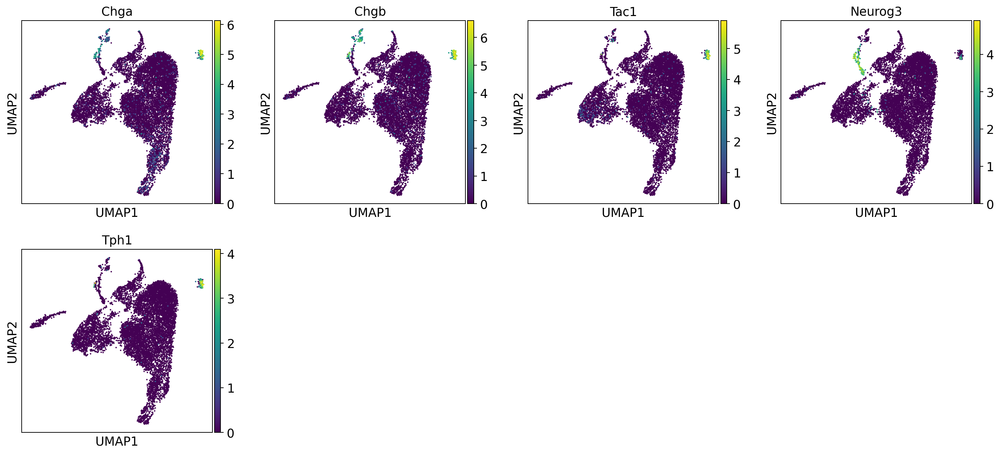

In [28]:
sc.pl.umap(adata,color=['Chga','Chgb','Tac1','Neurog3','Tph1']) ## enteroendocrine

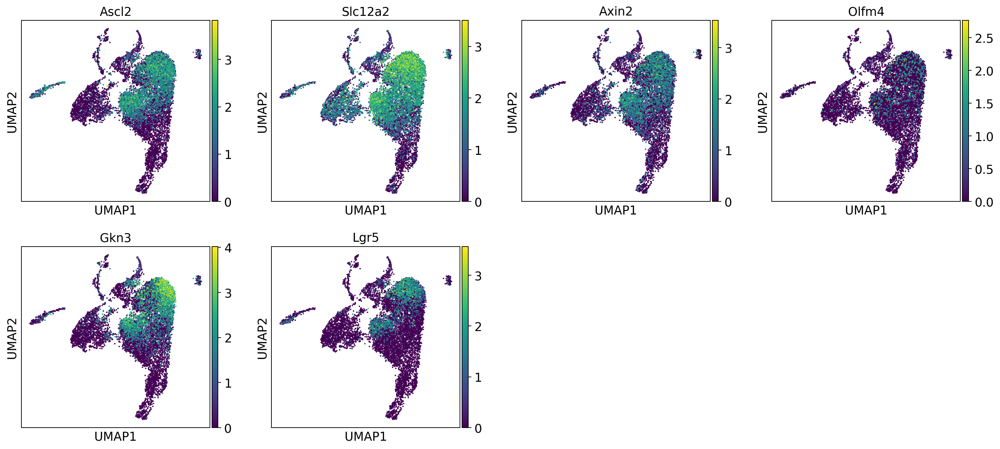

In [29]:
sc.pl.umap(adata,color=['Ascl2','Slc12a2','Axin2','Olfm4','Gkn3','Lgr5']) ## progenitor

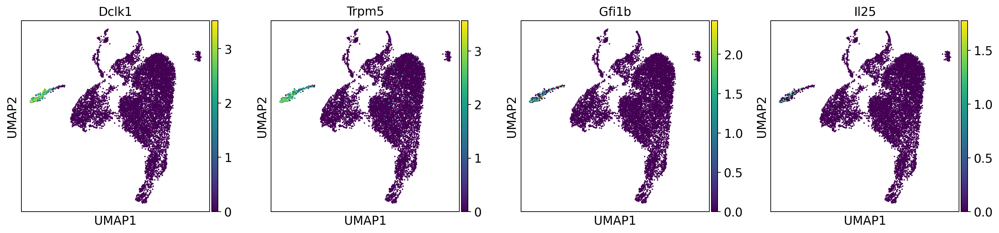

In [30]:
sc.pl.umap(adata,color=['Dclk1','Trpm5','Gfi1b','Il25']) ## Tuft/Brush

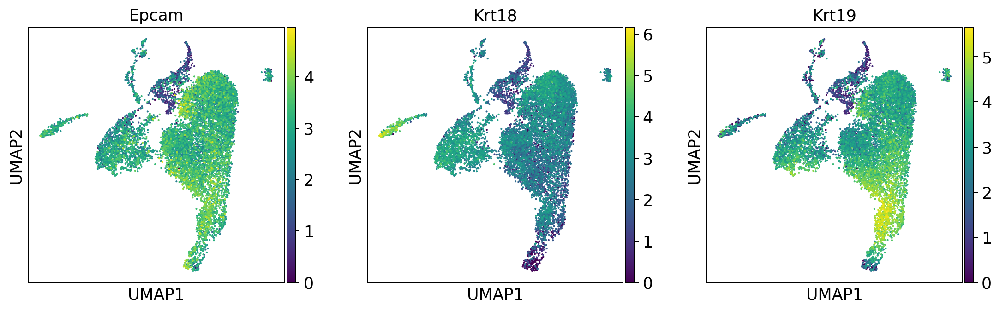

In [31]:
sc.pl.umap(adata,color=['Epcam','Krt18','Krt19']) ## Epithelial

#### Generate UMAPs for all signatures

In [32]:
scores = [x for x in adata_anno_scores.obs.columns if 'scanpy' in x]
sc.pl.umap(adata_anno_scores, color=scores, color_map='viridis')

# Compare to signature decision tree based annotation

In [33]:
from itertools import repeat

gmt_file_anno=pkg_resources.resource_filename('besca', 'datasets/genesets/CellNames_scseqCMs6_sigs.gmt')
mousehuman_homologs=pkg_resources.resource_filename('besca', 'datasets/homologs/MGItoHGNC.csv')

mousehuman=pd.read_csv(mousehuman_homologs, sep='\t',header='infer', encoding="unicode_escape")
mousehuman.index=mousehuman['MGI']
conversion = pd.Series(data=mousehuman.HGNC, index=mousehuman.index)

mymarkers = bc.tl.sig.read_GMT_sign(gmt_file_anno,directed=False)

for signature in mymarkers.keys():
    mymarkers[signature] = [i for i in map(bc.tl.sig._helper._to_geneid, repeat(conversion), mymarkers[signature]) if i is not None]

mymarkers = bc.tl.sig.filter_siggenes(adata, mymarkers) ### remove genes not present in dataset or empty signatures
mymarkers['Ubi'] = ['B2m','Actb'] ### used for cutoff adjustment - Gapdh not highly expressed in mouse

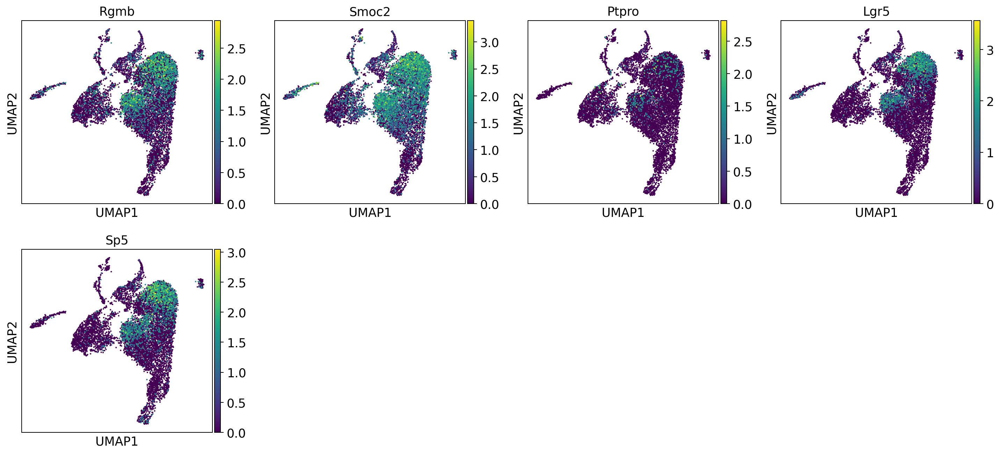

In [34]:
sc.pl.umap(adata,color=mymarkers['EpithelialStem'])

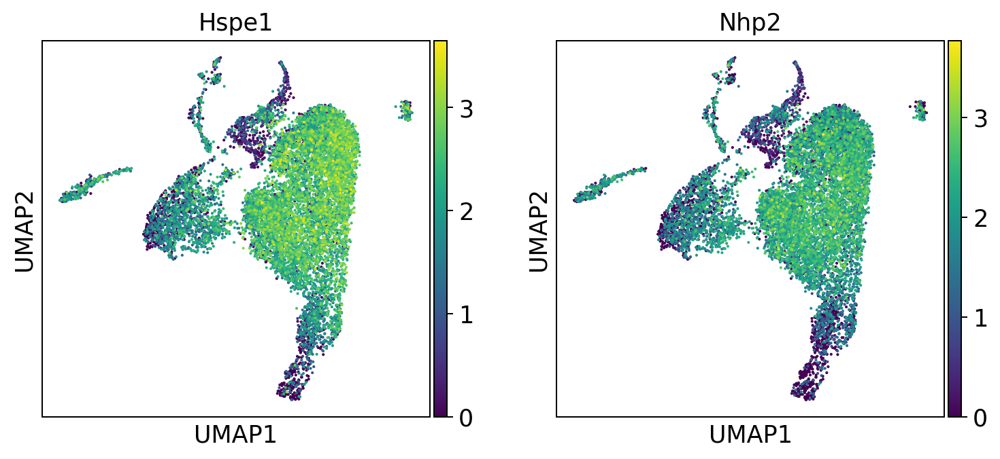

In [35]:
sc.pl.umap(adata,color=mymarkers['TAmplifying'])

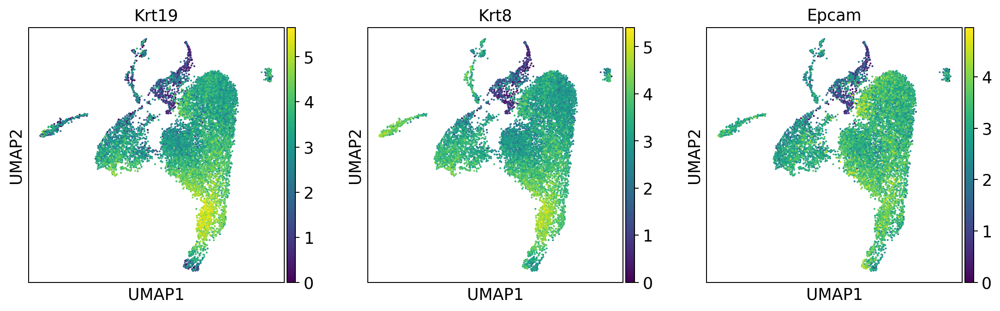

In [36]:
sc.pl.umap(adata,color=mymarkers['EnterocytePC'])

In [37]:
configfile=pkg_resources.resource_filename('besca', 'datasets/genesets/CellNames_scseqCMs6_config.mouse.tsv')

sigconfig,levsk=bc.tl.sig.read_annotconfig(configfile)


In [38]:
print(sigconfig.loc["Epithelial","Cutoff"])
print(sigconfig.loc["Paneth","Cutoff"])
print(sigconfig.loc["Goblet","Cutoff"])
print(sigconfig.loc["ImmatureGoblet","Cutoff"])
print(sigconfig.loc["Enterocyte","Cutoff"])
print(sigconfig.loc["EnterocytePC","Cutoff"])
print(sigconfig.loc["ImmatureEnterocyte","Cutoff"])
print(sigconfig.loc["TAmplifying","Cutoff"])
print(sigconfig.loc["ProlifTAmplifying","Cutoff"])
print(sigconfig.loc["EpithelialStem","Cutoff"])

2.5
2.0
1.5
2.0
2.5
1.5
1.5
2.0
2.5
2.0


In [39]:
sigconfig.loc["Epithelial","Cutoff"]=1.0
#sigconfig.loc["Paneth","Cutoff"]=2.0
sigconfig.loc["Goblet","Cutoff"]=1.8
sigconfig.loc["ImmatureGoblet","Cutoff"]=1.3
#sigconfig.loc["Enterocyte","Cutoff"]=2.5
sigconfig.loc["EnterocytePC","Cutoff"]=2.75
#sigconfig.loc["ProlifEnterocytePC","Cutoff"]=2.0
#sigconfig.loc["ImmatureEnterocyte","Cutoff"]=1.5
#sigconfig.loc["TAmplifying","Cutoff"]=2.0
#sigconfig.loc["ProlifTAmplifying","Cutoff"]=2.5
#sigconfig.loc["EpithelialStem","Cutoff"]=2.0
#sigconfig.loc["ProlifEpithelialStem","Cutoff"]=2.0

In [40]:
# Fract_pos was exported by BESCA in the standard worflow
f=pd.read_csv(results_folder + "/labelings/leiden/fract_pos.gct",sep="\t",skiprows=2)
df=bc.tl.sig.score_mw(f,mymarkers)
myc=np.median(df.loc['Ubi',:]*0.5) ### Set a cutoff based on Ubi and scale with values from config file

# Cluster attribution based on cutoff
df=df.drop('Ubi')


In [41]:
sigscores={}
for mysig in list(df.index):
    sigscores[mysig]=bc.tl.sig.getset(df,mysig,sigconfig.loc[mysig,'Cutoff']*myc)
    #sigscores[mysig]=bc.tl.sig.getset(df,mysig,10)

In [42]:
sigscores

{'Fibroblast': set(),
 'Endothelial': set(),
 'Epithelial': {'0',
  '1',
  '10',
  '11',
  '12',
  '13',
  '14',
  '15',
  '16',
  '17',
  '18',
  '19',
  '2',
  '20',
  '21',
  '22',
  '23',
  '24',
  '25',
  '26',
  '27',
  '28',
  '29',
  '3',
  '30',
  '31',
  '32',
  '33',
  '34',
  '35',
  '36',
  '37',
  '38',
  '4',
  '5',
  '6',
  '7',
  '8',
  '9'},
 'MelMelanoma': set(),
 'Myeloid': {'13', '32', '34', '35'},
 'CD8Tcell_IL7Rmax': set(),
 'CD4Tcell_IL7Rmax': set(),
 'RegTcell': set(),
 'NClassMonocyte': set(),
 'pDC': set(),
 'Hematopoietic': set(),
 'Blymphocyte': set(),
 'NaiCD4Tcell': set(),
 'NaiCD8Tcell': set(),
 'ProlifCD8Tcell': set(),
 'ProlifCD4Tcell': set(),
 'ProlifBcell': {'1',
  '10',
  '11',
  '12',
  '14',
  '19',
  '20',
  '21',
  '22',
  '24',
  '25',
  '28',
  '29',
  '7',
  '9'},
 'CMCD4Tcell': set(),
 'EMCD8Tcell': set(),
 'EMCD4Tcell': set(),
 'Macrophage_MARCO': set(),
 'CytotoxCD4Tcell': set(),
 'CytotoxCD8Tcell': set(),
 'ExhCD8Tcell': set(),
 'Langerha

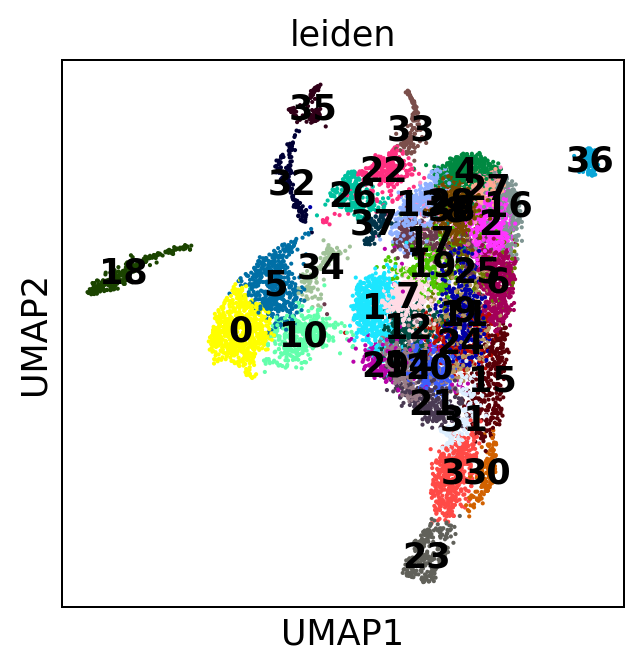

In [43]:
sc.pl.umap(adata, color=['leiden'], legend_loc='on data')

In [44]:
### One can choose to exclude certain cell types not relevant for the analysed sample 
### or which go too much into detail for the current resolution
#toexclude=['AlphaPancreatic', 'BetaPancreatic', 'DeltaPancreatic', 'PPcell', 'PancreaticDuctal', 'PancreaticAcinar', 
#           'EpsilonPancreatic', 'PancStellate', 'Cholangiocyte', 'Erythrocyte', 'Hematopoietic']
toexclude=['AlphaPancreatic', 'BetaPancreatic', 'DeltaPancreatic', 'PPcell', 'PancreaticDuctal', 'PancreaticAcinar', 
           'EpsilonPancreatic', 'PancStellate', 'Cholangiocyte','Hepatocyte']

In [45]:
cnames=bc.tl.sig.make_anno(df,sigscores,sigconfig,levsk, 'celltype',toexclude)

In [46]:
cnames

,celltype0,celltype1,celltype2,celltype3
4,Epithelial,EpithelialStem,EpithelialStem,EpithelialStem
3,Epithelial,Enterocyte,Enterocyte,Enterocyte
20,Epithelial,TAmplifying,ProlifTAmplifying,ProlifTAmplifying
29,Epithelial,EnterocytePC,ProlifEnterocytePC,ProlifEnterocytePC
5,Epithelial,ImmatureGoblet,ImmatureGoblet,ImmatureGoblet
16,Epithelial,EpithelialStem,EpithelialStem,EpithelialStem
25,Epithelial,TAmplifying,TAmplifying,TAmplifying
6,Epithelial,TAmplifying,TAmplifying,TAmplifying
9,Epithelial,TAmplifying,TAmplifying,TAmplifying
14,Epithelial,TAmplifying,ProlifTAmplifying,ProlifTAmplifying


In [47]:
adata.obs['celltype0']=bc.tl.sig.add_anno(adata,cnames,'celltype0','leiden')
adata.obs['celltype1']=bc.tl.sig.add_anno(adata,cnames,'celltype1','leiden')
adata.obs['celltype2']=bc.tl.sig.add_anno(adata,cnames,'celltype2','leiden')
adata.obs['celltype3']=bc.tl.sig.add_anno(adata,cnames,'celltype3','leiden')

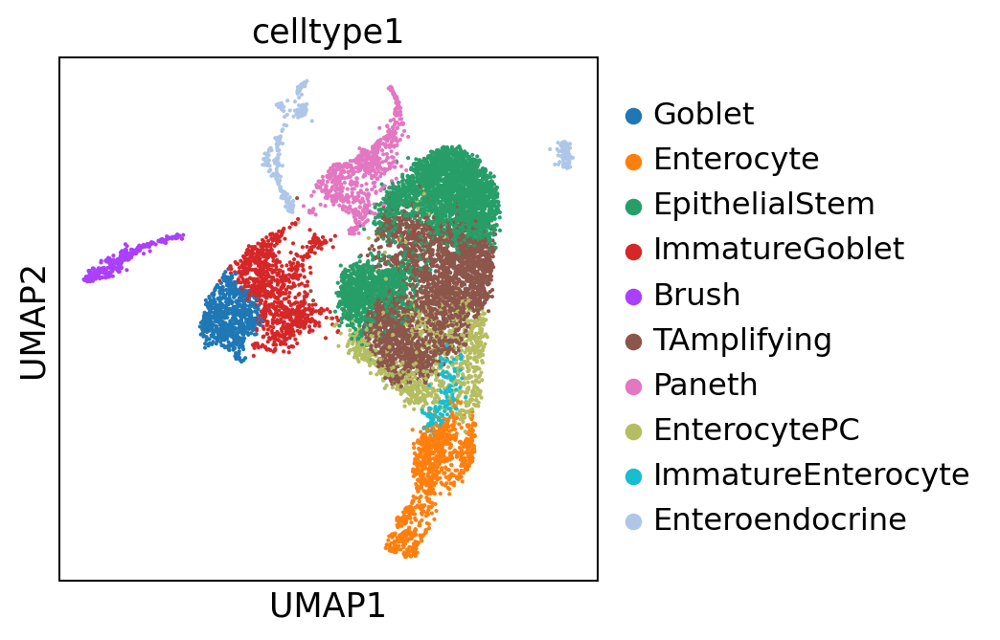

In [48]:
sc.pl.umap(adata,color=['celltype1'])

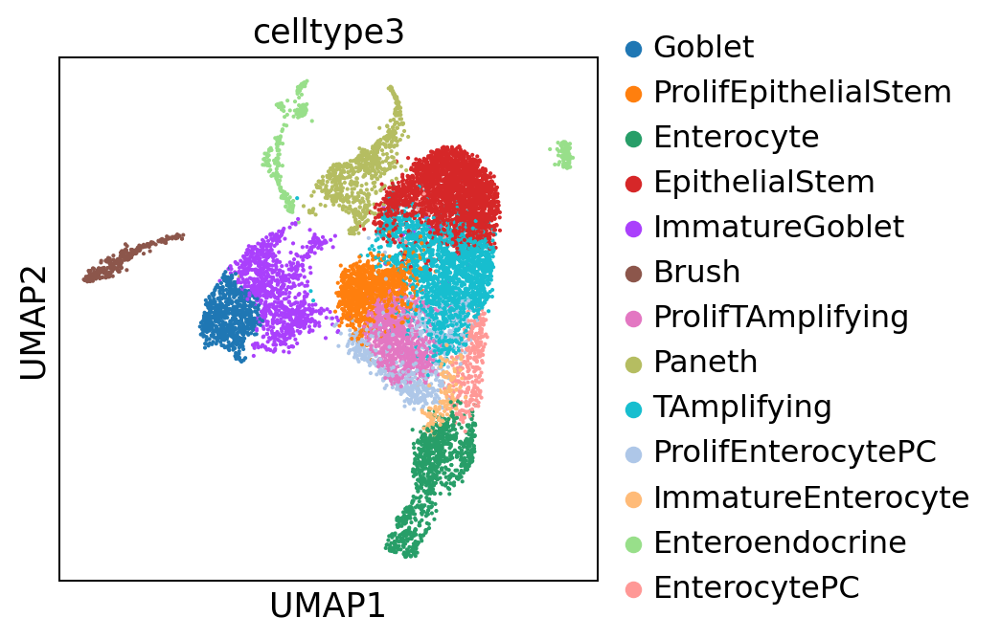

In [49]:
sc.pl.umap(adata,color=['celltype3'])

In [50]:
#sc.pl.umap(adata, color=['Subtype'])

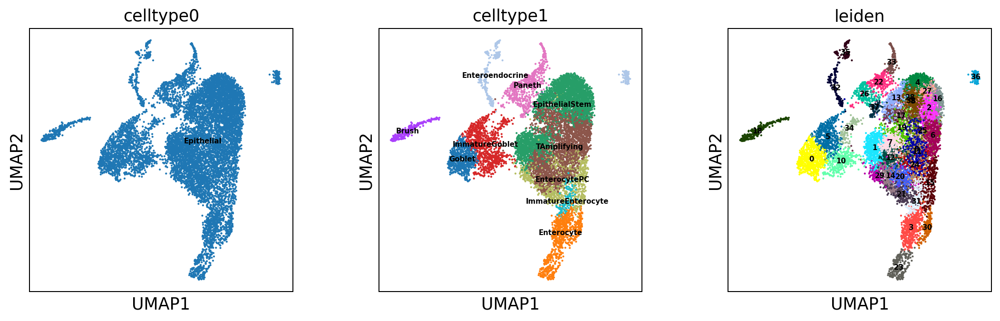

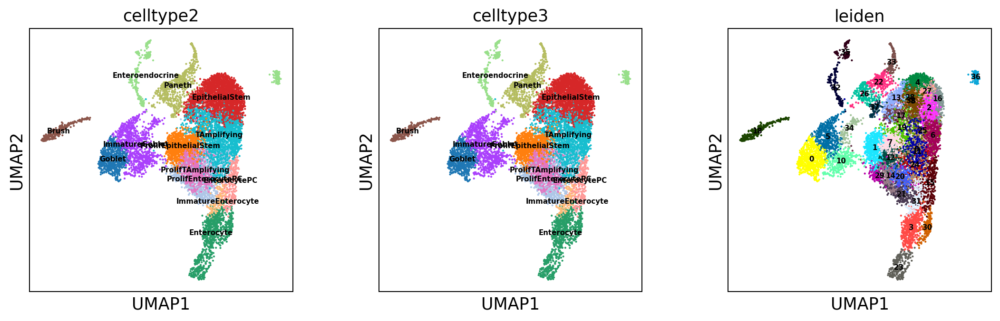

In [51]:
sc.pl.umap(adata, color=['celltype0','celltype1', 'leiden'], legend_loc='on data',legend_fontsize=6)
sc.pl.umap(adata, color=['celltype2','celltype3', 'leiden'], legend_loc='on data',legend_fontsize=6)

In [52]:
#sc.pl.umap(adata, color=['dblabel','celltype', 'leiden'], legend_loc='on data',legend_fontsize=6)
#sc.pl.umap(adata, color=['cluster_celltype'], legend_loc='on data',legend_fontsize=6)

In [53]:
### transform these short forms to dblabel - EFO standard nomenclature
celltype_nomenclature=pkg_resources.resource_filename('besca', 'datasets/nomenclature/CellTypes_v1.tsv')
nomenclature=pd.read_csv(celltype_nomenclature,sep='\t',header=0,skiprows=range(1, 2))
#tmp=nomenclature.loc[0,:].copy(); tmp[0]=tmp[1]="unknown"; tmp[2]="NCL:0001"; tmp[3]="Unknown"
#nomenclature=nomenclature.append(tmp)

cnamesDBlabel=[]
for mycol in list(cnames.columns):
    cnamesDBlabel.append([list(nomenclature.loc[nomenclature['short_dblabel']==x,'dblabel'])[0] for x in list(cnames[mycol])])
cnamesDBlabel=pd.DataFrame(cnamesDBlabel).transpose()
cnamesDBlabel.columns=cnames.columns
cnamesDBlabel.index=cnames.index

In [54]:
clusters='leiden'
adata.obs['celltype0']=bc.tl.sig.add_anno(adata,cnamesDBlabel,'celltype0',clusters)
adata.obs['celltype1']=bc.tl.sig.add_anno(adata,cnamesDBlabel,'celltype1',clusters)
adata.obs['celltype2']=bc.tl.sig.add_anno(adata,cnamesDBlabel,'celltype2',clusters)
adata.obs['celltype3']=bc.tl.sig.add_anno(adata,cnamesDBlabel,'celltype3',clusters)

In [55]:
### dblabel
adata.obs['dblabel']=adata.obs['celltype3']

In [56]:
#results_file
adata.write(input_data+'.annotated.h5ad')

# Markers from Paper
https://github.com/theislab/single-cell-tutorial/blob/master/latest_notebook/Case-study_Mouse-intestinal-epithelium_1906.ipynb

In [57]:
marker_genes = dict()
marker_genes['Stem'] = ['Lgr5', 'Ascl2', 'Slc12a2', 'Axin2', 'Olfm4', 'Gkn3']
marker_genes['Enterocyte (Proximal)'] = ['Gsta1','Rbp2','Adh6a','Apoa4','Reg3a','Creb3l3','Cyp3a13','Cyp2d26','Ms4a10','Ace','Aldh1a1','Rdh7','H2-Q2', 'Hsd17b6','Gstm3','Gda','Apoc3','Gpd1','Fabp1','Slc5a1','Mme','Cox7a1','Gsta4','Lct','Khk','Mttp','Xdh','Sult1b1', 'Treh','Lpgat1','Dhrs1','Cyp2c66','Ephx2','Cyp2c65','Cyp3a25','Slc2a2','Ugdh','Gstm6','Retsat','Ppap2a','Acsl5', 'Cyb5r3','Cyb5b','Ckmt1','Aldob','Ckb','Scp2','Prap1']
marker_genes['Enterocyte (Distal)'] = ['Tmigd1','Fabp6','Slc51b','Slc51a','Mep1a','Fam151a','Naaladl1','Slc34a2','Plb1','Nudt4','Dpep1','Pmp22','Xpnpep2','Muc3','Neu1','Clec2h','Phgr1','2200002D01Rik','Prss30','Cubn','Plec','Fgf15','Crip1','Krt20','Dhcr24','Myo15b','Amn','Enpep','Anpep','Slc7a9','Ocm','Anxa2','Aoc1','Ceacam20','Arf6','Abcb1a','Xpnpep1','Vnn1','Cndp2','Nostrin','Slc13a1','Aspa','Maf','Myh14']
marker_genes['Goblet'] = ['Agr2', 'Fcgbp', 'Tff3', 'Clca1', 'Zg16', 'Tpsg1', 'Muc2', 'Galnt12', 'Atoh1', 'Rep15', 'S100a6', 'Pdia5', 'Klk1', 'Pla2g10', 'Spdef', 'Lrrc26', 'Ccl9', 'Bace2', 'Bcas1', 'Slc12a8', 'Smim14', 'Tspan13', 'Txndc5', 'Creb3l4', 'C1galt1c1', 'Creb3l1', 'Qsox1', 'Guca2a', 'Scin', 'Ern2', 'AW112010', 'Fkbp11', 'Capn9', 'Stard3nl', 'Slc50a1', 'Sdf2l1', 'Hgfa', 'Galnt7', 'Hpd', 'Ttc39a', 'Tmed3', 'Pdia6', 'Uap1', 'Gcnt3', 'Tnfaip8', 'Dnajc10', 'Ergic1', 'Tsta3', 'Kdelr3', 'Foxa3', 'Tpd52', 'Tmed9', 'Spink4', 'Nans', 'Cmtm7', 'Creld2', 'Tm9sf3', 'Wars', 'Smim6', 'Manf', 'Oit1', 'Tram1', 'Kdelr2', 'Xbp1', 'Serp1', 'Vimp', 'Guk1', 'Sh3bgrl3', 'Cmpk1', 'Tmsb10', 'Dap', 'Ostc', 'Ssr4', 'Sec61b', 'Pdia3', 'Gale', 'Klf4', 'Krtcap2', 'Arf4', 'Sep15', 'Ssr2', 'Ramp1', 'Calr', 'Ddost']
marker_genes['Paneth'] = ['Gm15284', 'AY761184', 'Defa17', 'Gm14851', 'Defa22', 'Defa-rs1', 'Defa3', 'Defa24', 'Defa26', 'Defa21', 'Lyz1', 'Gm15292', 'Mptx2', 'Ang4']
marker_genes['Enteroendocrine'] = ['Chgb', 'Gfra3', 'Cck', 'Vwa5b2', 'Neurod1', 'Fev', 'Aplp1', 'Scgn', 'Neurog3', 'Resp18', 'Trp53i11', 'Bex2', 'Rph3al', 'Scg5', 'Pcsk1', 'Isl1', 'Maged1', 'Fabp5', 'Celf3', 'Pcsk1n', 'Fam183b', 'Prnp', 'Tac1', 'Gpx3', 'Cplx2', 'Nkx2-2', 'Olfm1', 'Vim', 'Rimbp2', 'Anxa6', 'Scg3', 'Ngfrap1', 'Insm1', 'Gng4', 'Pax6', 'Cnot6l', 'Cacna2d1', 'Tox3', 'Slc39a2', 'Riiad1']
marker_genes['Tuft'] = ['Alox5ap', 'Lrmp', 'Hck', 'Avil', 'Rgs13', 'Ltc4s', 'Trpm5', 'Dclk1', 'Spib', 'Fyb', 'Ptpn6', 'Matk', 'Snrnp25', 'Sh2d7', 'Ly6g6f', 'Kctd12', '1810046K07Rik', 'Hpgds', 'Tuba1a', 'Pik3r5', 'Vav1', 'Tspan6', 'Skap2', 'Pygl', 'Ccdc109b', 'Ccdc28b', 'Plcg2', 'Ly6g6d', 'Alox5', 'Pou2f3', 'Gng13', 'Bmx', 'Ptpn18', 'Nebl', 'Limd2', 'Pea15a', 'Tmem176a', 'Smpx', 'Itpr2', 'Il13ra1', 'Siglecf', 'Ffar3', 'Rac2', 'Hmx2', 'Bpgm', 'Inpp5j', 'Ptgs1', 'Aldh2', 'Pik3cg', 'Cd24a', 'Ethe1', 'Inpp5d', 'Krt23', 'Gprc5c', 'Reep5', 'Csk', 'Bcl2l14', 'Tmem141', 'Coprs', 'Tmem176b', '1110007C09Rik', 'Ildr1', 'Galk1', 'Zfp428', 'Rgs2', 'Inpp5b', 'Gnai2', 'Pla2g4a', 'Acot7', 'Rbm38', 'Gga2', 'Myo1b', 'Adh1', 'Bub3', 'Sec14l1', 'Asah1', 'Ppp3ca', 'Agt', 'Gimap1', 'Krt18', 'Pim3', '2210016L21Rik', 'Tmem9', 'Lima1', 'Fam221a', 'Nt5c3', 'Atp2a3', 'Mlip', 'Vdac3', 'Ccdc23', 'Tmem45b', 'Cd47', 'Lect2', 'Pla2g16', 'Mocs2', 'Arpc5', 'Ndufaf3']

In [58]:
sc.tl.rank_genes_groups(adata, groupby='leiden', key_added='rank_genes')

ranking genes
    finished: added to `.uns['rank_genes']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


In [59]:
cell_annotation = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes')
cell_annotation

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
Stem,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,...,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0
Enterocyte (Proximal),47.0,47.0,47.0,47.0,47.0,47.0,47.0,47.0,47.0,47.0,...,47.0,47.0,47.0,47.0,47.0,47.0,47.0,47.0,47.0,47.0
Enterocyte (Distal),44.0,44.0,44.0,44.0,44.0,44.0,44.0,44.0,44.0,44.0,...,44.0,44.0,44.0,44.0,44.0,44.0,44.0,44.0,44.0,44.0
Goblet,83.0,83.0,83.0,83.0,83.0,83.0,83.0,83.0,83.0,83.0,...,83.0,83.0,83.0,83.0,83.0,83.0,83.0,83.0,83.0,83.0
Paneth,14.0,14.0,14.0,14.0,14.0,14.0,14.0,14.0,14.0,14.0,...,14.0,14.0,14.0,14.0,14.0,14.0,14.0,14.0,14.0,14.0
Enteroendocrine,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0,...,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0
Tuft,95.0,95.0,95.0,95.0,95.0,95.0,95.0,95.0,95.0,95.0,...,95.0,95.0,95.0,95.0,95.0,95.0,95.0,95.0,95.0,95.0


<AxesSubplot:>

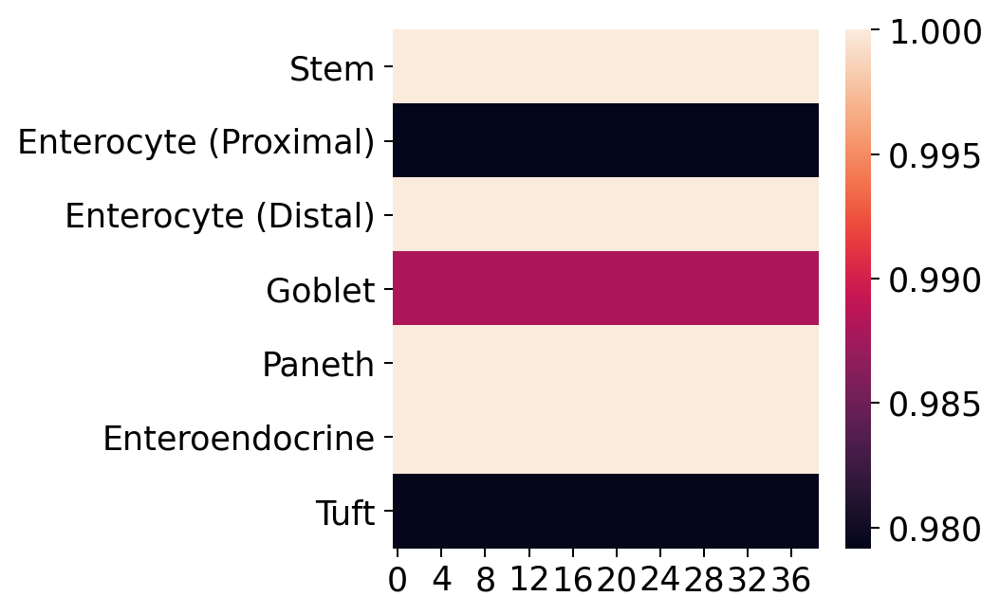

In [60]:
import seaborn as sb
cell_annotation_norm = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes', normalize='reference')
sb.heatmap(cell_annotation_norm)

In [61]:
cell_annotation_norm

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
Stem,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Enterocyte (Proximal),0.979167,0.979167,0.979167,0.979167,0.979167,0.979167,0.979167,0.979167,0.979167,0.979167,...,0.979167,0.979167,0.979167,0.979167,0.979167,0.979167,0.979167,0.979167,0.979167,0.979167
Enterocyte (Distal),1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Goblet,0.988095,0.988095,0.988095,0.988095,0.988095,0.988095,0.988095,0.988095,0.988095,0.988095,...,0.988095,0.988095,0.988095,0.988095,0.988095,0.988095,0.988095,0.988095,0.988095,0.988095
Paneth,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Enteroendocrine,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Tuft,0.979381,0.979381,0.979381,0.979381,0.979381,0.979381,0.979381,0.979381,0.979381,0.979381,...,0.979381,0.979381,0.979381,0.979381,0.979381,0.979381,0.979381,0.979381,0.979381,0.979381


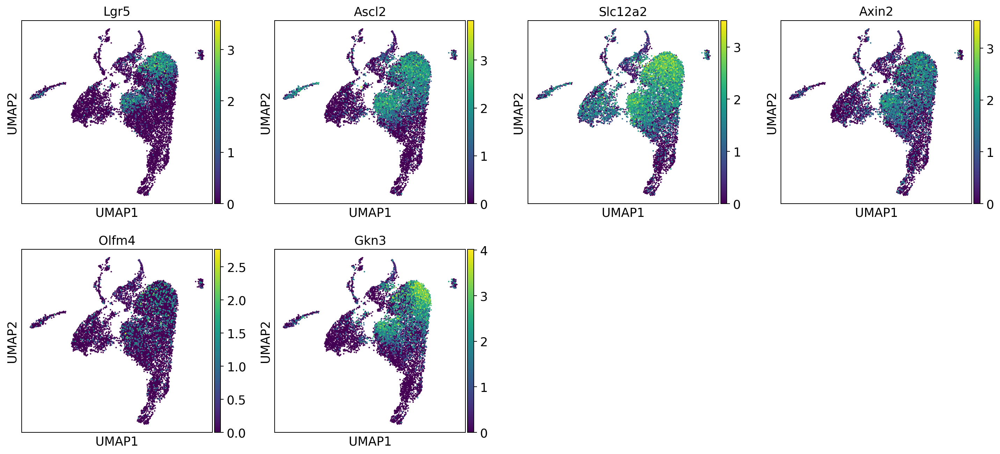

In [62]:
sc.pl.umap(adata,color=[g for g in marker_genes['Stem'] if g in adata.raw.var_names])

In [63]:
data_file_pub = './GSE92332_Regional_UMIcounts.txt'

adata_pub = sc.read(data_file_pub, cache=True)
adata_pub = adata_pub.transpose()

... reading from cache file cache/GSE92332_Regional_UMIcounts.h5ad


In [64]:
# Annotate the data sets
adata_pub.obs['barcode'] = [a.split('_')[0] for a in adata_pub.obs_names]
adata_pub.obs['region'] = [a.split('_')[1] for a in adata_pub.obs_names]
adata_pub.obs['donor'] = [a.split('_')[2].upper() for a in adata_pub.obs_names]
adata_pub.obs['cell_label'] = [a.split('_')[3] for a in adata_pub.obs_names]

In [65]:
#Cell type annotation from publication
print(adata_pub.shape)
adata_pub.obs['cell_label'].value_counts()

(11665, 27998)


Stem               3679
TA                 2311
EP                 1957
Goblet             1559
Enterocyte         1041
Paneth              529
Enteroendocrine     324
Tuft                265
Name: cell_label, dtype: int64

In [66]:
#Our cell type labels
print(adata.shape)
adata.obs['celltype3'].value_counts()

(10896, 1233)


epithelial fate stem cell                  2303
transit amplifying cell                    1886
proliferating epithelial fate stem cell    1006
immature goblet cell                        933
proliferating transit amplifying cell       890
enterocyte                                  876
goblet cell                                 663
paneth cell                                 647
proliferating enterocyte progenitor         634
enteroendocrine cell                        325
enterocyte progenitor                       318
brush cell                                  271
immature enterocyte                         144
Name: celltype3, dtype: int64

In [67]:
#Our cell type labels
print(adata.shape)
adata.obs['leiden'].value_counts()

(10896, 1233)


0     663
1     600
2     500
3     488
4     466
5     462
6     442
7     406
8     390
9     367
10    355
11    338
12    319
13    308
14    306
15    289
16    285
17    277
18    271
19    266
20    265
21    263
22    253
23    241
24    215
25    196
26    195
27    181
28    173
29    156
30    147
31    144
32    139
33    120
34    116
35    102
36     84
37     79
38     29
Name: leiden, dtype: int64

In [68]:
# Annotate the data sets
adata.obs['barcode'] = [a.split('.')[1] for a in adata.obs_names]

In [69]:
adata_merged = adata.copy()
adata_merged.obs = adata.obs.merge(adata_pub.obs.drop_duplicates(subset=['barcode', 'donor']), how='left', on=['barcode', 'donor'], indicator=True)

AnnData expects .obs.index to contain strings, but your first indices are: Int64Index([0, 1], dtype='int64'), …


In [70]:
adata.obs.shape

(10896, 17)

In [71]:
adata_pub.obs.shape

(11665, 4)

In [72]:
adata_merged.obs.shape

(10896, 20)

In [73]:
adata_merged.obs['_merge'].value_counts()

both          10291
left_only       605
right_only        0
Name: _merge, dtype: int64

In [74]:
#adata_merged = bc.st.additional_labeling(adata_merged, 'cell_label', 'cell_label', 'Cell type annotation from autors', 'Haber et al 2017', outdir_data)

In [75]:
#results_file
adata_merged.write(input_data+'.annotated.h5ad')

... storing 'donor' as categorical
... storing 'region_y' as categorical
... storing 'cell_label' as categorical


In [76]:
adata_merged.obs.cell_label

0            Paneth
1        Enterocyte
2                TA
3                TA
4              Stem
            ...    
10891            EP
10892    Enterocyte
10893        Goblet
10894        Goblet
10895    Enterocyte
Name: cell_label, Length: 10896, dtype: category
Categories (9, object): [EP, Enterocyte, Enteroendocrine, Goblet, ..., Stem, TA, Tuft, nan]

In [77]:
adata_merged = adata_merged.copy()
adata_merged = bc.subset_adata(adata_merged, adata_merged.obs.cell_label != 'nan', raw=False)

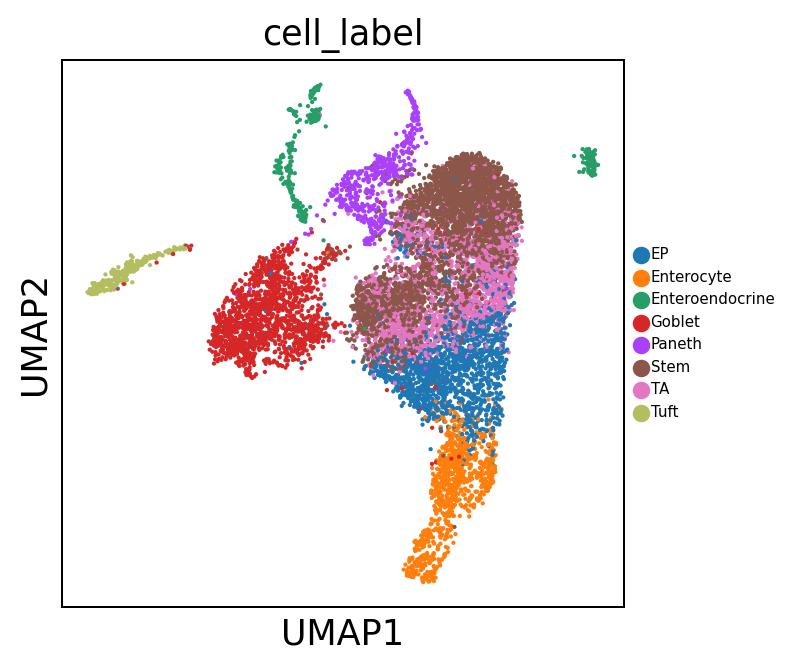

In [78]:
sc.pl.umap(adata_merged, color=['cell_label'],legend_fontsize=6)

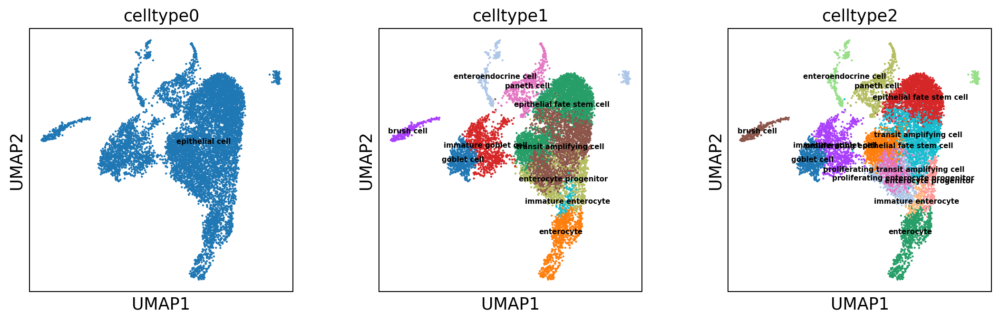

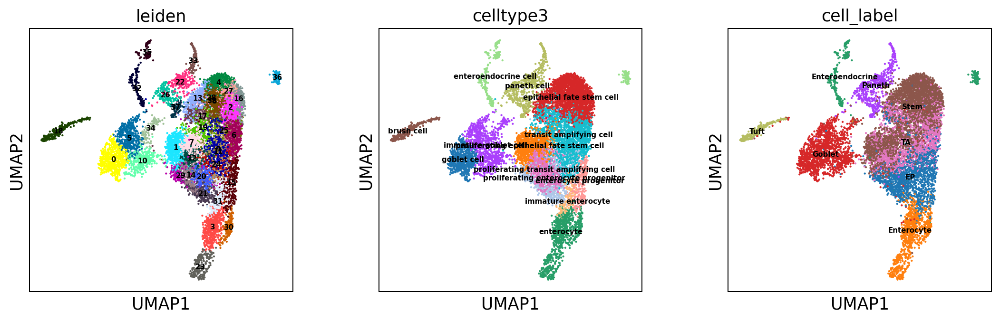

In [79]:
sc.pl.umap(adata_merged, color=['celltype0','celltype1', 'celltype2'], legend_loc='on data',legend_fontsize=6)
sc.pl.umap(adata_merged, color=['leiden','celltype3', 'cell_label'], legend_loc='on data',legend_fontsize=6)

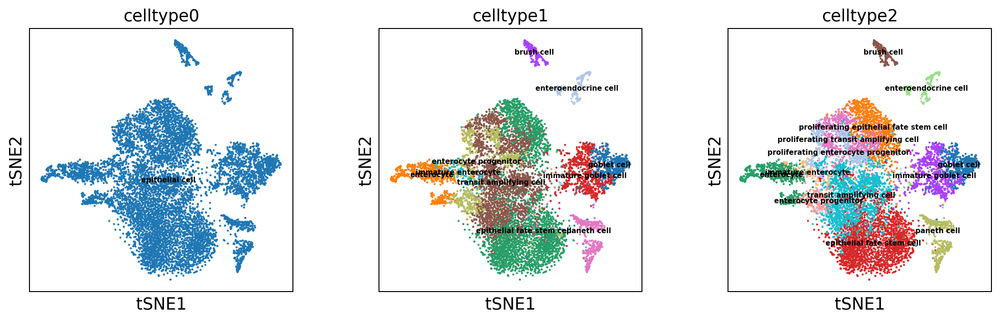

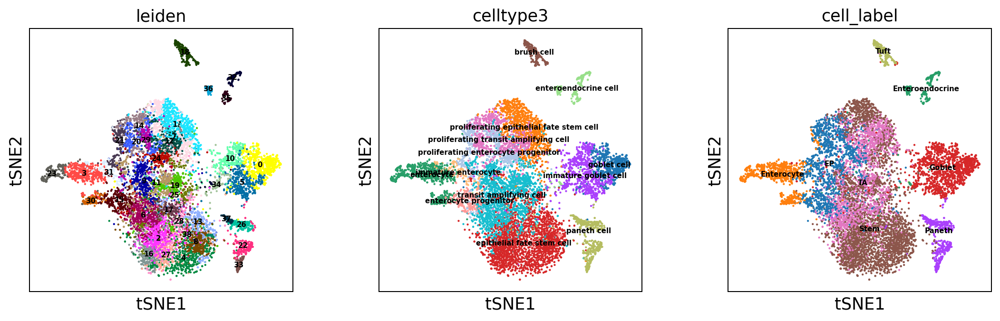

In [80]:
sc.pl.tsne(adata_merged, color=['celltype0','celltype1', 'celltype2'], legend_loc='on data',legend_fontsize=6)
sc.pl.tsne(adata_merged, color=['leiden','celltype3', 'cell_label'], legend_loc='on data',legend_fontsize=6)

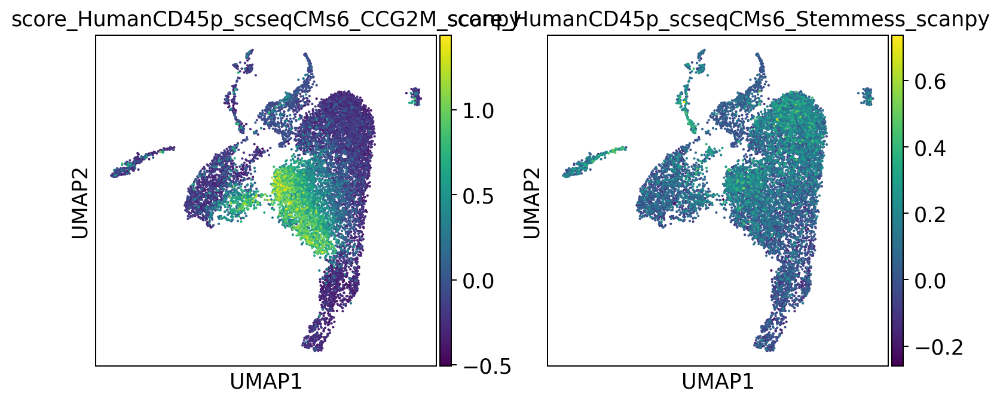

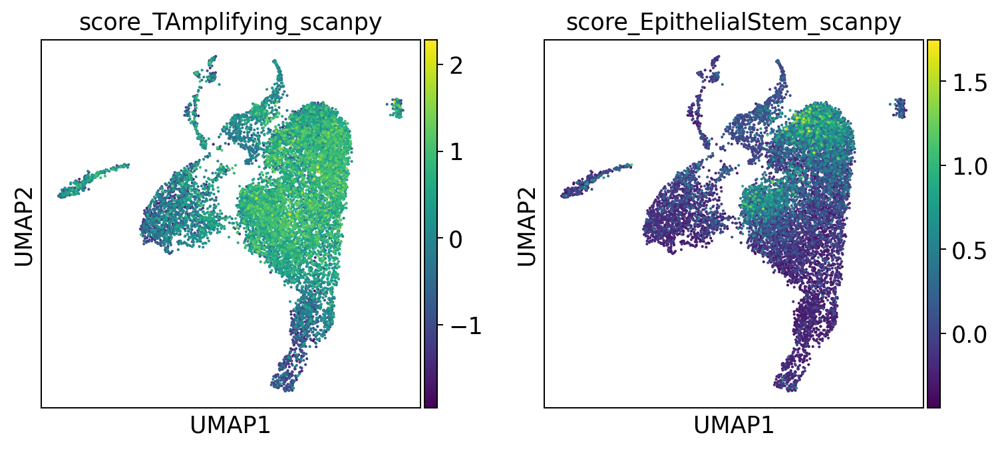

In [81]:
sc.pl.umap(adata_IMM_scores, color=['score_HumanCD45p_scseqCMs6_CCG2M_scanpy',
                                    'score_HumanCD45p_scseqCMs6_Stemmess_scanpy',
                                    ], legend_loc='on data',legend_fontsize=6)
sc.pl.umap(adata_anno_scores, color=['score_TAmplifying_scanpy',
                                     'score_EpithelialStem_scanpy',                                     
                                    ], legend_loc='on data',legend_fontsize=6)

In [82]:
bc.pl.riverplot_2categories(adata_merged, ['celltype3', 'cell_label'])


In [83]:
bc.pl.riverplot_2categories(adata_merged, ['celltype3', 'leiden'])


In [84]:
bc.pl.riverplot_2categories(adata_merged, ['leiden', 'cell_label'])


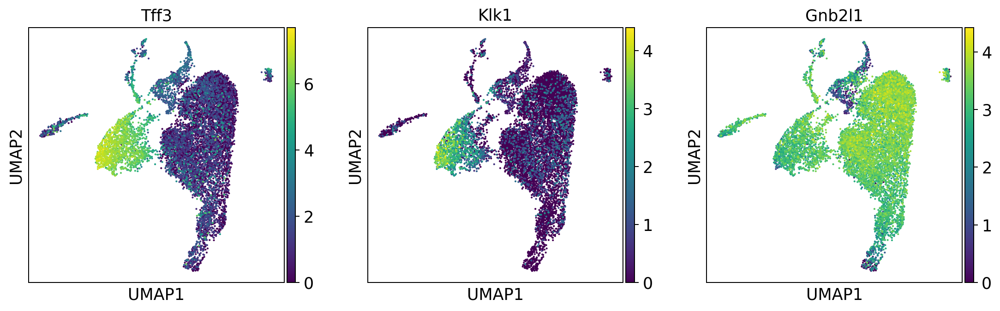

In [85]:
sc.pl.umap(adata_IMM_scores, color=['Tff3', 'Klk1', 'Gnb2l1'], legend_loc='on data',legend_fontsize=6)


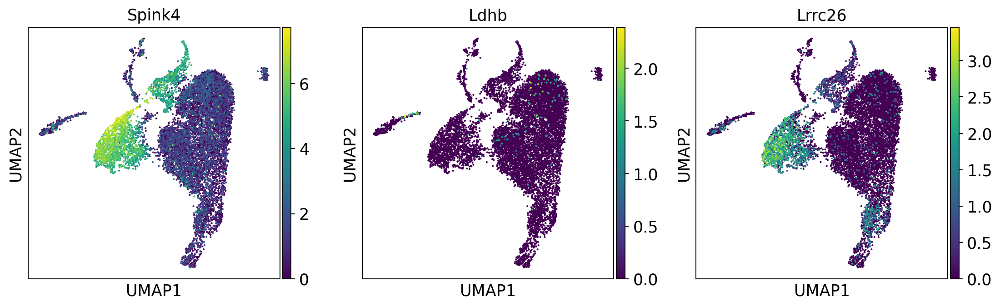

In [86]:
sc.pl.umap(adata_IMM_scores, color=['Spink4', 'Ldhb', 'Lrrc26'], legend_loc='on data',legend_fontsize=6)


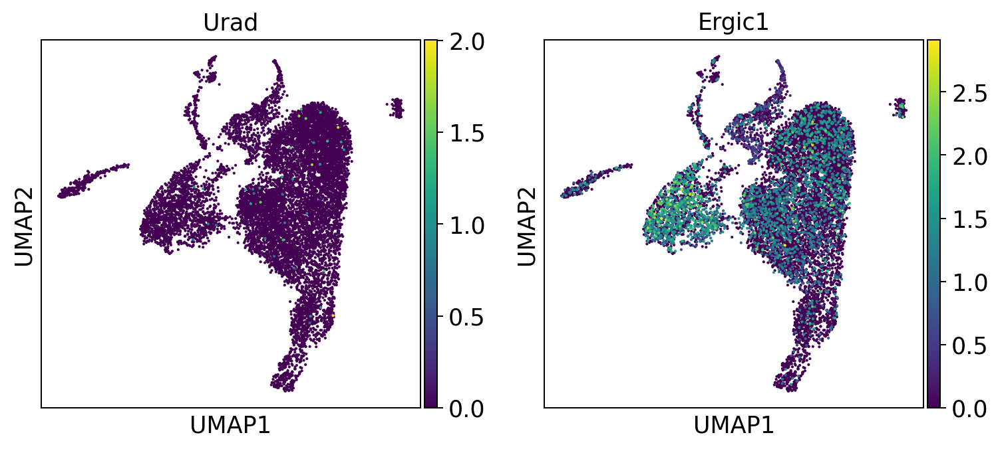

In [87]:
sc.pl.umap(adata_IMM_scores, color=['Urad', 'Ergic1'], legend_loc='on data',legend_fontsize=6)


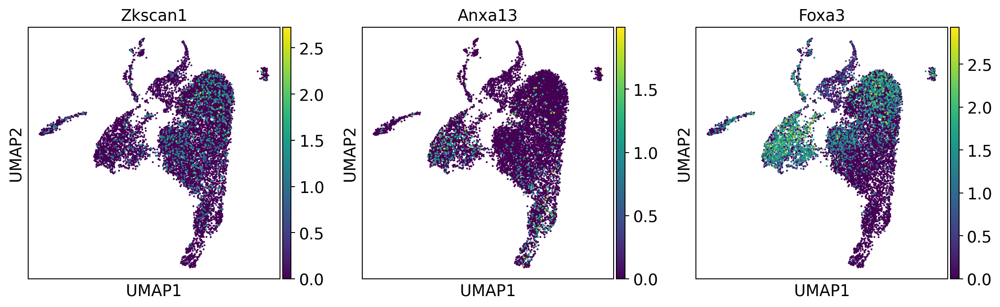

In [88]:
sc.pl.umap(adata_IMM_scores, color=['Zkscan1', 'Anxa13', 'Foxa3'], legend_loc='on data',legend_fontsize=6)
